# Step 9: 2D Laplace Equation

We previously completed a solution to the 2D Burger's Equation and we move now onto solving the Laplace and Poisson Equations in the next two steps. The 2D Burger's equation was important in our study of fluid mechanics because it contains the full convective nonlinearity of the flow equations. But with this exercise we build our experience incrementally to code a Navier-Stokes solver.

Here is Laplace's Equation in 2D:

$$ \frac{\partial^2 p}{\partial x^2} + \frac{\partial^2 p}{\partial y^2} = 0 $$


## Discretization

We've built a pretty good amount of experience in discretizing these terms, even for 2nd order derivatives. But looking at this for a minute &mdash; Laplace's equation has features that are typical of diffusion phenomena. For this reason, it has to be discretized using central differences, so that the discretization is consistent with the physics we want to simulate.

The discretization equation is:

$$ \frac{p^n_{i+1,j}  - 2p^n_{i,j} + p^n_{i-1,j}}{\Delta x^2} + \frac{p^n_{i,j+1} - 2p^n_{i,j} + p^n_{i,j-1}}{\Delta y^2} = 0
$$

Notice that the Laplace Equation does not have a time dependence &mdash; there is no $p^n+1$ term. Instead of tracking a wave through time &mdash; as we have done in the previous steps &mdash; the laplace equation calculates the equilibrium state of a system under the supplied boundary conditions. If you are familiar with Heat Transfer, you will recognize this as the steady-state heat equation.

That is, this equation does not calcualte where the system will be after some time *t*, instead it iteratively solves for $p^n_{i,j}$ until it meets a condition that we specify. The equilibrium state will only be reached after $\infty$ iterations so we cannot easily decide when to stop. Instead, we will iterate until the change between one iteration and the next one becomes significantly small. 

Rearranging the discretized equation we can get:

$$ p^n_{i,j} = \frac{\Delta y^2 (p^n_{i+1,j} + p^n_{i-1,j})+ \Delta x^2 (p^n_{i,j+1} + p^n_{i,j-1})}{2(\Delta x^2 + \Delta y^2 )}
$$

Using second-order-central-difference schemes in both direction is the most widely applied method for discretizing the Laplace Equations. It is also known as the **five-point difference operator**.

## Initial and Boundary Conditions

We solve the Laplace equation numerically by assuming an initial state of p = 0 everywhere. Then we add the following boundary conditions. 

$p = 0 \ \text{at} \ x = 0 $

$p = y \ \text{at} \ x = 2 $

$\frac{\partial p}{\partial y} = 0 \ \text{at} \  y = 0, 1 $ 

Under these specific conditions there is an analytical solution that we can use for Laplace's Equation:

$$ p(x,y) = \frac{x}{4} - 4 \sum_{n=1,odd}^{\infty} \frac{1}{(n \pi)^2 \sinh 2n \pi} \sinh n \pi x \cos n \pi y $$

## Libraries and Variable declarations

### Lib import

In [1]:
# Adding inline command to make plots appear under comments
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
%matplotlib notebook

## Function Declarations

In [2]:
def plot2D(x,y,p):
    fig = plt.figure(figsize=(11,7), dpi=100)
    ax = fig.gca(projection='3d')
    X,Y = np.meshgrid(x,y)
    surf = ax.plot_surface(X, Y, p[:], rstride=1, cstride=1, cmap=cm.viridis,
            linewidth=0, antialiased=False)
    ax.set_xlim(0,2)
    ax.set_ylim(0,1)
    ax.view_init(30,225)
    ax.set_xlabel('$x$')
    ax.set_zlabel('$p$')
    ax.set_ylabel('$y$')
    ax.text2D(0.35, 0.95, "2D Laplace Equations", transform=ax.transAxes);
    #ax.grid(False)
    #ax.set_xticks([])
    #ax.set_yticks([])
    #ax.set_zticks([])
    #plt.axis('off')
    #plt.savefig('laplace.png')

The `plot2D` function takes three arguments, an ax-vector, a y-vector and our p-matrix and given these values creates a 3D projection plot.

In [3]:
def laplace2D(p, y, dx, dy, l1norm_target):
    l1norm = 1
    pn = np.empty_like(p)
    count = 0
    while l1norm > l1norm_target: 
        count +=1
        pn = p.copy()
        p[1:-1, 1:-1] = ((dy**2 * (pn[1:-1, 2:] + pn[1:-1, 0:-2]) +
                         dx**2 * (pn[2:, 1:-1] + pn[0:-2, 1:-1])) /
                        (2 * (dx**2 + dy**2)))
            
        p[:, 0] = 0  # p = 0 @ x = 0
        p[:, -1] = y  # p = y @ x = 2
        p[0, :] = p[1, :]  # dp/dy = 0 @ y = 0
        p[-1, :] = p[-2, :]  # dp/dy = 0 @ y = 1
        l1norm = (np.sum(np.abs(p[:]) - np.abs(pn[:])) /
                np.sum(np.abs(pn[:])))
    print(count)   
    return p

### Variable Declarations

In [4]:
grid_length_x = 2
grid_length_y = 1
grid_points_x = 31
grid_points_y = 31
c = 1
dx = grid_length_x / (grid_points_x - 1) 
dy = grid_length_y / (grid_points_y - 1) 

p = np.zeros((grid_points_x, grid_points_y))

x = np.linspace(0, grid_length_x, grid_points_x)
y = np.linspace(0, grid_length_y, grid_points_y)


#Initiallizing the array containing the shape of our initial conditions
p[:,0] = 0
p[:,-1] = y
p[0,:] = p[1,:]
p[-1,:] = p[-2,:]

### Plotting initial conditions

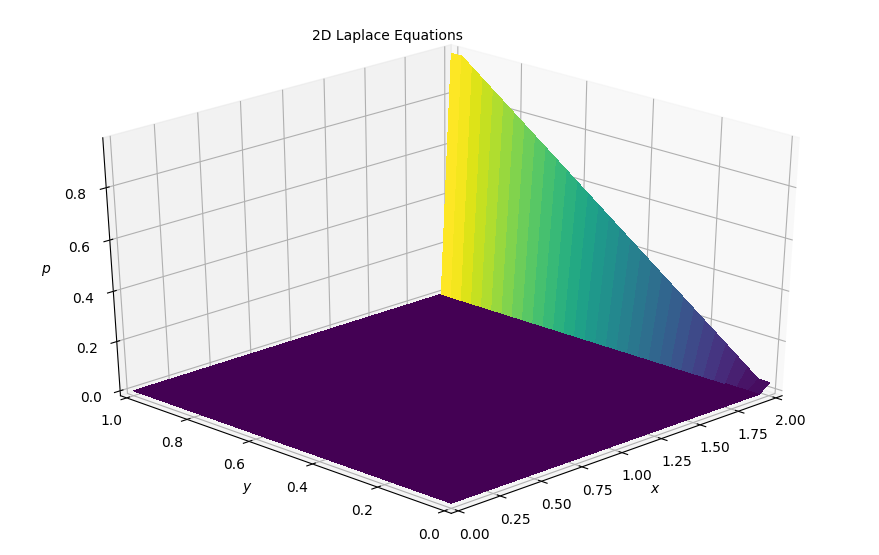

In [5]:
plot2D(x,y,p)

## Solving in 2D

In [6]:
p = laplace2D(p, y, dx, dy, 1e-4)

2042


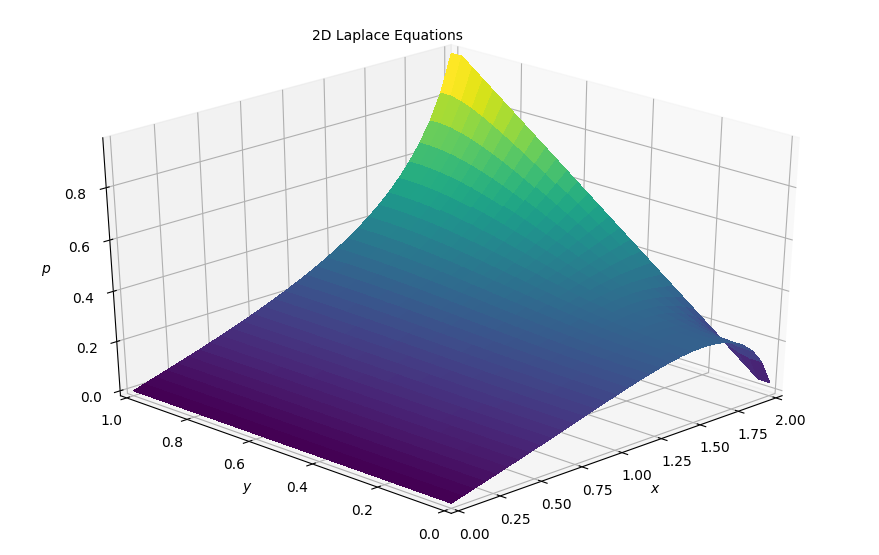

In [7]:
plot2D(x,y,p)

### Results

Pretty cool to see the final steady solution. Let's now attempt to animate it and get an evolution of the solution.

## Animating the simulation

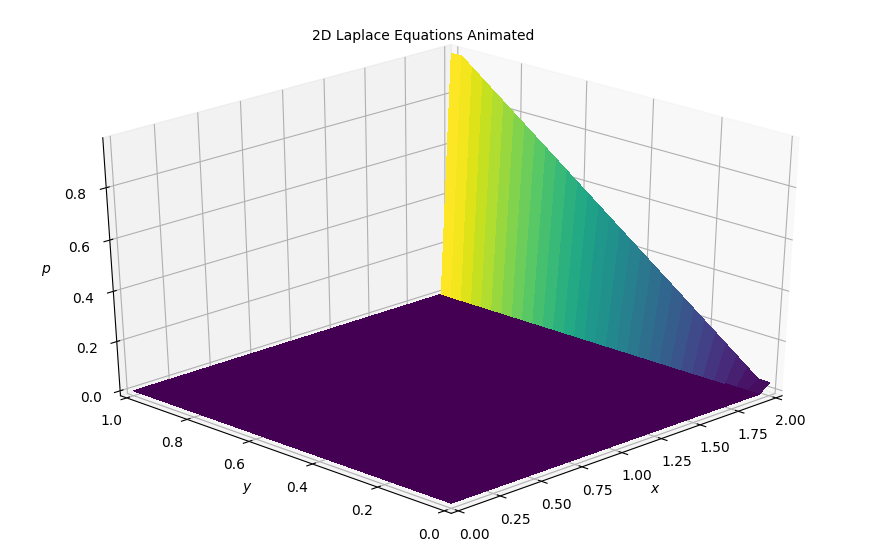

In [8]:
#Imports for animation and display within a jupyter notebook
from matplotlib import animation, rc 
from IPython.display import HTML

#Resetting the U wave back to initial conditions
p = np.zeros((grid_points_x, grid_points_y))
p[:,0] = 0
p[:,-1] = y
p[0,:] = p[1,:]
p[-1,:] = p[-2,:]

#Generating the figure that will contain the animation

pn = np.empty_like(p)
fig = plt.figure(figsize=(11,7), dpi=100)
ax = fig.gca(projection='3d')
X,Y = np.meshgrid(x,y)
surf = ax.plot_surface(X, Y, p[:], rstride=1, cstride=1, cmap=cm.viridis,
            linewidth=0, antialiased=False)
ax.set_xlim(0,2)
ax.set_ylim(0,1)
ax.view_init(30,225)
ax.set_xlabel('$x$')
ax.set_zlabel('$p$')
ax.set_ylabel('$y$')
ax.text2D(0.35, 0.95, "2D Laplace Equations Animated", transform=ax.transAxes);

In [9]:
#Initialization function for funcanimation
def init():
    ax.clear()
    surf = ax.plot_surface(X, Y, p[:], rstride=1, cstride=1, cmap=cm.viridis,
            linewidth=0, antialiased=False)
    return surf

In [10]:
#Main animation function, each frame represents a time step in our calculation
def animate(j):
    

    pn = p.copy()
    p[1:-1, 1:-1] = ((dy**2 * (pn[1:-1, 2:] + pn[1:-1, 0:-2]) +
                     dx**2 * (pn[2:, 1:-1] + pn[0:-2, 1:-1])) /
                    (2 * (dx**2 + dy**2)))

    p[:, 0] = 0  # p = 0 @ x = 0
    p[:, -1] = y  # p = y @ x = 2
    p[0, :] = p[1, :]  # dp/dy = 0 @ y = 0
    p[-1, :] = p[-2, :]  # dp/dy = 0 @ y = 1
    
    ax.clear()
    surf = ax.plot_surface(X, Y, p[:], rstride=1, cstride=1, cmap=cm.viridis,
            linewidth=0, antialiased=False)
    ax.set_xlim(0,2)
    ax.set_ylim(0,1)
    ax.view_init(30,225)
    ax.set_xlabel('$x$')
    ax.set_zlabel('$p$')
    ax.set_ylabel('$y$')
    ax.text2D(0.35, 0.95, "2D Laplace Equations Animated", transform=ax.transAxes);
    return surf

In [11]:
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=200, interval=20)
HTML(anim.to_jshtml())

Animation size has reached 21076398 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


## Conclusion

Next we will move on to solving Poisson's equation in 2D.